In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
cd gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained/

/content/gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained


In [ ]:
cd domain_r_5/

/content/gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained/domain_r_5


In [ ]:
ls

animation_of_fields_rho_v_u.mp4            kymo_u_with_wound_boundary.pdf
controlled_vs_uncontrolled_wound_area.png  u_traj_run1_R_5.npz
density_control_combined.mp4               u_traj_run2_R_5.npz


[it 0000] J=334.302831  r_w(T)=0.0785  t_on=[1.08492298 8.57242558]  r_c=[1.83070367 1.16976518]  edge=2.852e-02  mass=4.835e-05  safe=4.006e-05  jam=1.434e+00  offV=1.600e-01  t1pen=3.444e-02
[it 0050] J=260.249372  r_w(T)=0.0785  t_on=[0.54175657 7.89012832]  r_c=[2.13650859 1.50817429]  edge=2.842e-02  mass=3.438e-05  safe=2.652e-07  jam=1.064e+00  offV=1.421e-01  t1pen=5.377e-04
[it 0100] J=255.320611  r_w(T)=0.0785  t_on=[0.54373521 7.89407324]  r_c=[2.18074595 1.55955701]  edge=2.847e-02  mass=3.179e-05  safe=1.120e-07  jam=1.102e+00  offV=1.419e-01  t1pen=5.416e-04
[it 0150] J=253.982891  r_w(T)=0.0785  t_on=[0.54357958 7.89367737]  r_c=[2.19293501 1.57477242]  edge=2.849e-02  mass=3.110e-05  safe=8.732e-08  jam=1.119e+00  offV=1.419e-01  t1pen=5.413e-04
[it 0200] J=253.382926  r_w(T)=0.0785  t_on=[0.54360246 7.89370624]  r_c=[2.19836665 1.58174085]  edge=2.849e-02  mass=3.079e-05  safe=7.803e-08  jam=1.128e+00  offV=1.419e-01  t1pen=5.413e-04
[it 0250] J=253.052308  r_w(T)=0.07

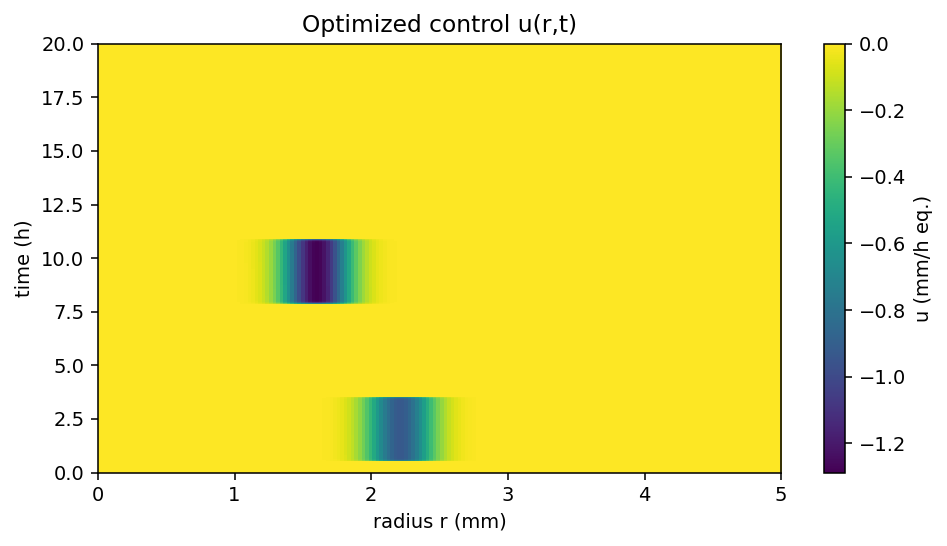

In [ ]:
# ==============================================================
# Backprop-like optimal control for wound closure (JAX)
# Kinematic edge law:      r_w' = v(r_w,t)
# Stationary ring centers: frozen while each pulse is ON
# Safety & realism:        safe standoff, jamming avoidance,
#                          optional between-pulse damping
# Regularizers:            ∫∫ |∂ρ/∂r|^2, |∂ρ/∂t|^2, |∂u/∂r|^2, |∂u/∂t|^2
# Mass correction:         multiplicative, evaluated on guarded tissue
# Void guard (FIXED):      keep ρ≈0 for r < r_w (with optional inner band)
# Timing preference:       encourage first pulse t_on[0] ∈ [T1_MIN, T1_MAX]
#
# Fixes:
#   • Logical ON/OFF is time-based.
#   • Amplitude window is CROPPED by ON: W = W_raw * on_f  (no tails).
#   • u_tp_acc accumulation is scalar.
# ==============================================================

import jax
jax.config.update("jax_enable_x64", True)

import jax.numpy as jnp
import optax
import numpy as np
import matplotlib.pyplot as plt

# ------------------------- Hyperparams -------------------------

# Geometry / time
R      = 5.0
T      = 20.0
Nr     = 192
Nt     = 1600

# Physics
D      = 0.02
CHI    = 0.25 #earlier it was 0.25
NU     = 0.15 #was 0.25 before

# Device / control
NPULSES    = 2          # number of pulses
TAU        = 3.0        # pulse duration [h]
GMIN, GMAX = 4.0, 5.0   # gap range between pulses [h] earlier it was (2,3)
J0         = 0.9        # control amplitude (inward bias)# was 0.5 before
SIGMA_R    = 0.175        # ring width [mm] #was 0.5 before
S_MIN      = 0.3        # min standoff [mm] was 0.5 before
L_PROP     = 1.0        # max standoff [mm] was 1.5 before
EPS_T      = 0.05       # smooth window edge [h]

# Realism & safety (experimental feedback)
S_SAFE     = 0.4        # mm minimum standoff while a pulse is ON # was 0.6 before
BETA_SAFE  = 10.0       # smooth hinge sharpness for standoff safety
L_SAFE     = 1.0        # weight: safety integral
L_JAM      = 0.2        # weight: discourage r_c2 ~ r_c1
SIGMA_JAM  = 0.25       # mm for "jamming proximity"
L_DAMP_OFF = 1.0        # optional: penalize |v|^2 when all pulses OFF

# Objective weights
L_WOUND    = 1.0e4      # r_w(T)^2
L_EDGE     = 1.0        # outward edge velocity penalty (hinge on v_edge>0)
L_MASS     = 10.0       # soft mass penalty (accumulator scaled later)
BETA_HINGE = 10.0       # smooth hinge for edge outward motion

# Derivative-regularization weights
L_RHO_RS   = 1.0
L_RHO_RT   = 1.0
L_U_RS     = 1.0
L_U_RT     = 1.0

# Timing preference for first pulse
T1_MIN     = 0.0        # h
T1_MAX     = 1.0        # h
L_TON1     = 1.0e3      # weight of first-pulse timing penalty
BETA_TON   = 5.0        # smooth-hinge sharpness for timing penalty

# Differentiability / stability
KMASK     = 6.0
RHO_FLOOR = 1e-8
RHO_MAX   = 10.0
EPS_DEN   = 1e-10
EPS_MASK  = 1e-8
LAMBDA_MC = 1.0

# Void guard (keep ~0 density inside wound)
N_GUARD_CELLS = 20
KVOID          = 120.0
HARD_GUARD     = False

# Numerics (grid)
r   = jnp.linspace(0.0, R, Nr)
dr  = R / (Nr - 1)
dt  = T / Nt
tgrid = jnp.linspace(0.0, T, Nt+1)

SIGMA_J = max(2.0*dr, 2.0*(R/Nr))  # smooth edge sampler width

# -------------------- Differential operators -------------------

def _pad_edge(x): return jnp.pad(x, (1,1), mode='edge')

def grad_r(f):
    fp = _pad_edge(f)
    return (fp[2:] - fp[:-2]) / (2.0*dr)

def lap_r(f):
    fp = _pad_edge(f)
    ddf = (fp[2:] - 2.0*fp[1:-1] + fp[:-2]) / (dr**2)
    df  = (fp[2:] - fp[:-2]) / (2.0*dr)
    return ddf + df/(r + 1e-12)

def div_r_flux(F):
    g  = r * F
    gp = _pad_edge(g)
    dgr= (gp[2:] - gp[:-2]) / (2.0*dr)
    return dgr / (r + 1e-12)

# --------------- Helmholtz A matrix: (I - NU * L_r) ------------

def helmholtz_matrix(r_vec: jnp.ndarray, dr: float, nu: float, eps_diag: float = 1e-8) -> jnp.ndarray:
    r_loc = jnp.asarray(r_vec)
    n = r_loc.shape[0]
    invdr2  = 1.0 / (dr**2)
    inv2rdr = 1.0 / (2.0 * jnp.where(r_loc > 0.0, r_loc, 1.0) * dr)
    a = invdr2 - inv2rdr
    b = (-2.0 * invdr2) * jnp.ones_like(r_loc)
    c = invdr2 + inv2rdr
    # Neumann rows
    a = a.at[0].set(0.0);            b = b.at[0].set(-2.0*invdr2); c = c.at[0].set( 2.0*invdr2)
    a = a.at[-1].set( 2.0*invdr2);   b = b.at[-1].set(-2.0*invdr2); c = c.at[-1].set(0.0)
    diag  = 1.0 - nu * b
    lower = -nu * a
    upper = -nu * c
    A = jnp.diag(diag) + jnp.diag(upper[:-1], 1) + jnp.diag(lower[1:], -1)
    A = A + eps_diag * jnp.eye(n)
    return A

A_HELM = helmholtz_matrix(r, dr, NU, eps_diag=1e-8)

# ---------------------- Control parametrization ----------------

def sigmoid(x): return jax.nn.sigmoid(x)

def map_params(phi):
    if NPULSES == 1:
        assert phi.shape[-1] == 2
        a, c = phi[...,0], phi[...,1]
        t1 = (T - TAU) * sigmoid(a)
        d1 = S_MIN + (L_PROP - S_MIN) * sigmoid(c)
        return jnp.array([t1]), jnp.array([d1])
    else:
        assert phi.shape[-1] == 4
        a, b, c, d = phi[...,0], phi[...,1], phi[...,2], phi[...,3]
        g  = GMIN + (GMAX - GMIN) * sigmoid(b)
        t1 = (T - 2.0*TAU - g) * sigmoid(a)
        t2 = t1 + TAU + g
        d1 = S_MIN + (L_PROP - S_MIN) * sigmoid(c)
        d2 = S_MIN + (L_PROP - S_MIN) * sigmoid(d)
        return jnp.array([t1, t2]), jnp.array([d1, d2])

def window_top_hat(t, t_on):
    # Smooth amplitude (will be cropped by ON)
    rise = jnp.tanh((t - t_on)/EPS_T)
    fall = jnp.tanh((t - (t_on + TAU))/EPS_T)
    return 0.5 * (rise - fall)

def ring_kernel(r, rc): return jnp.exp(-0.5 * ((r - rc)/SIGMA_R)**2)

# ------------------------ Void guard mask (FIXED) ---------------

def guard_mask(r, r_w):
    if HARD_GUARD:
        return jnp.where(r <= r_w, 0.0, 1.0)
    core = jax.nn.sigmoid(KVOID * (r - r_w))
    thr_ext = jnp.maximum(r_w - N_GUARD_CELLS * dr, 0.0)
    ext = jax.nn.sigmoid(KVOID * (r - thr_ext))
    return core * ext

# -------------------- Initial condition (tanh) ------------------

def rho_init_tanh(r_w0, rho_max=1.0, width=0.25):
    raw = rho_max * 0.5 * (1.0 + jnp.tanh((r - r_w0) / width))
    g0  = guard_mask(r, r_w0)
    rho0 = raw * g0
    m0  = jax.nn.sigmoid(KMASK * (r - r_w0))
    M0  = jnp.sum(rho0 * m0 * r) * dr
    return rho0, M0

# ---------------------- Smooth edge sampling --------------------

def smooth_edge_weight(r, r_w):
    w = jnp.exp(-0.5 * ((r - r_w)/SIGMA_J)**2)
    w = w / (jnp.sum(w) + 1e-12)
    return w

# ---------------------- Smooth interval penalty ----------------

def interval_penalty(x, a, b, beta=5.0):
    below = jax.nn.softplus(beta * (a - x)) / beta
    above = jax.nn.softplus(beta * (x - b)) / beta
    return below**2 + above**2

# ---------------------- One simulation step ---------------------

@jax.jit
def step_carry(carry, n, t_on, d_off, M_target):
    (rho, r_w,
     rc_state, was_on,
     edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
     rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
     u_prev) = carry

    t = n * dt

    # Tissue masks
    m          = jax.nn.sigmoid(KMASK * (r - r_w))
    gmask_now  = guard_mask(r, r_w)
    m_eff      = m * gmask_now

    # Amplitude (smooth) and logical ON (time-based)
    W_raw = jax.vmap(window_top_hat, in_axes=(None, 0))(t, t_on)  # (P,)
    ON    = jnp.logical_and(t >= t_on, t < (t_on + TAU))          # (P,)
    on_f  = ON.astype(r.dtype)
    W     = W_raw * on_f                                          # <<< crop tails

    # Freeze centers when first turning ON
    became_on = jnp.logical_and(ON, jnp.logical_not(was_on))
    rc_state  = jnp.where(became_on, r_w + d_off, rc_state)
    was_on    = ON

    # Control u
    def one_kernel(rc_p, Wp):
        g  = ring_kernel(r, rc_p) * m
        Z  = jnp.sum(g * r) * dr + EPS_DEN
        return (g / Z) * Wp
    K_all = jax.vmap(one_kernel)(rc_state, W)
    u = -J0 * jnp.sum(K_all, axis=0)
    u = jnp.nan_to_num(u, 0.0, 0.0, 0.0)

    # Velocity
    rhs_v = -CHI * grad_r(rho) + u
    rhs_v = jnp.nan_to_num(rhs_v, 0.0, 0.0, 0.0)
    v = jnp.linalg.solve(A_HELM, rhs_v)
    v = m_eff * v

    # PDE step on guarded density
    rho_tissue = rho * gmask_now
    diff = D * lap_r(rho_tissue)
    adv  = -div_r_flux(rho_tissue * v)
    rhs  = (diff + adv) * m_eff
    rho_new = rho + dt * jnp.nan_to_num(rhs, 0.0, 0.0, 0.0)
    rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

    # Mass correction (tissue only)
    M_new = jnp.sum(rho_new * m_eff * r) * dr
    s = (M_target) / (M_new + EPS_DEN)
    rho_new = rho_new * (1.0 + LAMBDA_MC * (s - 1.0) * m_eff)
    rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

    # Edge kinematics
    w_edge  = smooth_edge_weight(r, r_w)
    v_edge  = jnp.sum(w_edge * v)
    r_w_new = jnp.clip(r_w + dt * v_edge, 3.0*dr, R - 3.0*dr)

    # Penalties / regularizers
    hinge = jax.nn.softplus(BETA_HINGE * v_edge) / BETA_HINGE
    edge_acc = edge_acc + (hinge**2) * dt

    dist = rc_state - r_w_new
    viol = jax.nn.softplus(BETA_SAFE * (S_SAFE - dist)) / BETA_SAFE
    safe_acc = safe_acc + jnp.sum((viol**2) * on_f) * dt

    if NPULSES == 2:
        d12 = rc_state[1] - rc_state[0]
        jam = jnp.exp(-0.5 * (d12 / SIGMA_JAM)**2)
    else:
        jam = 0.0
    jam_acc = jam_acc + jam * dt

    all_off  = jnp.prod(1.0 - on_f)
    offV_acc = offV_acc + all_off * (jnp.sum((v**2) * m_eff * r) * dr) * dt

    wT = m_eff * r
    gr_rho     = grad_r(rho_new)
    rho_sp_acc = rho_sp_acc + jnp.sum((gr_rho**2) * wT) * dr * dt
    gt_rho     = (rho_new - rho) / dt
    rho_tp_acc = rho_tp_acc + jnp.sum((gt_rho**2) * wT) * dr * dt

    gr_u     = grad_r(u)
    u_sp_acc = u_sp_acc + jnp.sum((gr_u**2) * wT) * dr * dt
    gt_u     = (u - u_prev) / dt
    u_tp_acc = u_tp_acc + jnp.sum((gt_u**2) * wT) * dr * dt  # scalar

    # Project with updated guard
    gmask_new = guard_mask(r, r_w_new)
    rho_new   = jnp.clip(rho_new * gmask_new, RHO_FLOOR, RHO_MAX)

    return (
        rho_new, r_w_new,
        rc_state, was_on,
        edge_acc,
        mass_acc + ((M_new - M_target)**2) * dt,
        safe_acc, jam_acc, offV_acc,
        rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
        u
    ), ()

# ---------------------- Loss (value & grad) ---------------------

def rollout_and_loss(phi, r_w0, rho0, M_target):
    t_on, d_off = map_params(phi)
    t1_pen = interval_penalty(t_on[0], T1_MIN, T1_MAX, BETA_TON) if NPULSES >= 1 else 0.0

    rc0     = jnp.zeros((NPULSES,))
    was_on0 = jnp.zeros((NPULSES,), dtype=bool)
    u0      = jnp.zeros_like(r)

    carry0 = (rho0, r_w0,
              rc0, was_on0,
              0.0, 0.0, 0.0, 0.0, 0.0,
              0.0, 0.0, 0.0, 0.0,
              u0)

    (rhoT, r_wT,
     rc_state, was_on,
     edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
     rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
     _), _ = jax.lax.scan(
        lambda c, n: step_carry(c, n, t_on, d_off, M_target),
        carry0, jnp.arange(Nt)
    )

    J = (
        L_WOUND * (r_wT**2)
        + L_EDGE * edge_acc
        + L_MASS * mass_acc
        + L_SAFE * safe_acc
        + L_JAM  * jam_acc
        + L_DAMP_OFF * offV_acc
        + L_RHO_RS * rho_sp_acc + L_RHO_RT * rho_tp_acc
        + L_U_RS   * u_sp_acc   + L_U_RT   * u_tp_acc
        + L_TON1   * t1_pen
    )
    return J, (r_wT, edge_acc, mass_acc, safe_acc, jam_acc, offV_acc, t_on, d_off, rc_state, t1_pen)

loss_and_grad = jax.value_and_grad(
    lambda ph, r_w0, rho0, M_target: rollout_and_loss(ph, r_w0, rho0, M_target)[0]
)

# ------------------- Optimize (Adam via Optax) ------------------

def solve_with_grad(r_w0=2.5, rho_max=1.0, width=0.25, steps=800, lr=0.05, seed=0):
    rho0, M_target = rho_init_tanh(r_w0, rho_max=rho_max, width=width)

    if NPULSES == 1:
        phi = jnp.array([-2.0, 0.0])
    else:
        phi = jnp.array([-2.0, 0.0, 0.0, 0.0])  # [a,b,c,d]

    opt = optax.adam(lr)
    opt_state = opt.init(phi)

    @jax.jit
    def step(phi, opt_state):
        J, grads = loss_and_grad(phi, r_w0, rho0, M_target)
        updates, opt_state = opt.update(grads, opt_state, phi)
        phi_new = optax.apply_updates(phi, updates)
        return phi_new, opt_state, J

    history = []
    for it in range(steps):
        phi, opt_state, J = step(phi, opt_state)
        if it % 50 == 0 or it == steps-1:
            Jv, aux = rollout_and_loss(phi, r_w0, rho0, M_target)
            r_wT, edge_acc, mass_acc, safe_acc, jam_acc, offV_acc, t_on, d_off, rc_state, t1_pen = aux
            print(f"[it {it:04d}] J={float(Jv):.6f}  r_w(T)={float(r_wT):.4f}  "
                  f"t_on={np.array(t_on)}  r_c={np.array(rc_state)}  "
                  f"edge={float(edge_acc):.3e}  mass={float(mass_acc):.3e}  "
                  f"safe={float(safe_acc):.3e}  jam={float(jam_acc):.3e}  "
                  f"offV={float(offV_acc):.3e}  t1pen={float(t1_pen):.3e}")
        history.append(float(J))
    return phi, history, (rho0, M_target)

# --------------------- Post-optimization sims ------------------

@jax.jit
def full_rollout(phi, r_w0=2.5, rho_max=1.0, width=0.25):
    rho0, M_target = rho_init_tanh(r_w0, rho_max=rho_max, width=width)
    t_on, d_off = map_params(phi)

    rc0     = jnp.zeros((NPULSES,))
    was_on0 = jnp.zeros((NPULSES,), dtype=bool)
    u0      = jnp.zeros_like(r)

    carry0 = (rho0, r_w0,
              rc0, was_on0,
              0.0, 0.0, 0.0, 0.0, 0.0,
              0.0, 0.0, 0.0, 0.0,
              u0)

    def body(carry, n):
        (rho, r_w,
         rc_state, was_on,
         edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
         rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
         u_prev), _ = step_carry(carry, n, t_on, d_off, M_target)

        # Rebuild u for plotting with CROPPED amplitude (matches dynamics)
        t = n * dt
        m = jax.nn.sigmoid(KMASK * (r - r_w))
        W_raw = jax.vmap(window_top_hat, in_axes=(None, 0))(t, t_on)
        ON    = jnp.logical_and(t >= t_on, t < (t_on + TAU))
        W     = W_raw * ON.astype(r.dtype)

        def one_kernel(rc_p, Wp):
            g  = ring_kernel(r, rc_p) * m
            Z  = jnp.sum(g * r) * dr + 1e-12
            return (g / Z) * Wp

        K_all = jax.vmap(one_kernel)(rc_state, W)
        u = -J0 * jnp.sum(K_all, axis=0)

        return (rho, r_w,
                rc_state, was_on,
                edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
                rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
                u_prev), (r_w, u)

    (_, _, _, _, _, _, _, _, _, _, _, _, _, _), (rws, Us) = jax.lax.scan(
        body, carry0, jnp.arange(Nt)
    )
    return jnp.array(rws), jnp.array(Us)

# ----------------------------- Run -----------------------------

if __name__ == "__main__":
    phi_star, hist, ic = solve_with_grad(
        r_w0=1.25, rho_max=1.0, width=0.25,
        steps=800, lr=0.05, seed=0
    )

    t_on_star, d_off_star = map_params(phi_star)
    print("\nBest (feasible) parameters:")
    print("  t_on  =", np.array(t_on_star))
    print("  d_off =", np.array(d_off_star), "(standoff from r_w at turn-on)")

    RW, Utraj = full_rollout(phi_star, r_w0=1.25, rho_max=1.0, width=0.25)
    TT = np.linspace(0.0, T, Nt)


    # # --- Save control trajectory + grids + a few params (compressed) ---
    # out_path = "u_traj_run2_R_5.npz"
    # np.savez_compressed(
    # out_path,
    # U=np.asarray(Utraj),          # shape (Nt, Nr)
    # r=np.asarray(r),              # shape (Nr,)
    # t=TT.astype(float),           # shape (Nt,)
    # extent=np.array([0.0, R, TT[0], TT[-1]], dtype=float),
    # phi_star=np.asarray(phi_star) # learned parameters (optional, for record)
    # )
    # print(f"Saved control to {out_path} with keys:", np.load(out_path).files)

    plt.figure(figsize=(7,4), dpi=140)
    extent = [0, R, TT[0], TT[-1]]
    plt.imshow(np.array(Utraj), aspect='auto', origin='lower',
               extent=extent, interpolation='nearest')
    plt.colorbar(label='u (mm/h eq.)')
    plt.xlabel("radius r (mm)"); plt.ylabel("time (h)")
    plt.title("Optimized control u(r,t)")
    plt.tight_layout(); plt.show()


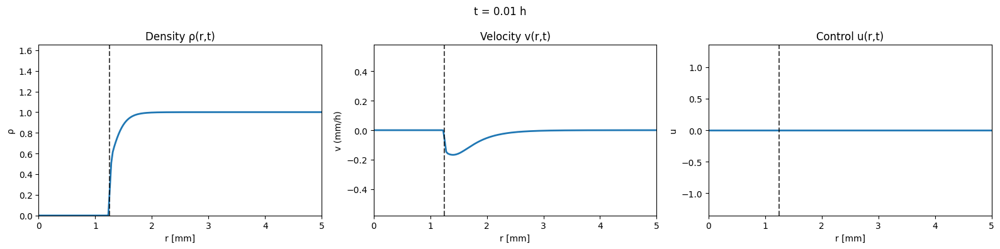

In [ ]:
# ================= Profiles-vs-radius animation (ρ, v, u) =================
from matplotlib import animation
from IPython.display import HTML

USE_GUARD_FOR_PLOTS = True  # multiply u,v by guard_mask for display (matches solver masking of v)

def _uv_from_state_stationary(rho, r_w, rc_state, t, t_on):
    """
    Recompute u(r) and v(r) at time t using the *stationary* ring centers rc_state
    (frozen the first time each pulse turned ON). This mirrors the solver logic:
      • kernels normalized on tissue mask m
      • v masked by m_eff = m * guard_mask
      • amplitude window is smooth but CROPPED by time-based ON → no short bursts
    """
    # soft tissue mask (around current edge)
    m = jax.nn.sigmoid(KMASK * (r - r_w))
    # strong void guard (keeps interior ~zero)
    gmask_now = guard_mask(r, r_w)
    m_eff = m * gmask_now

    # smooth amplitude + time-based ON, then crop
    W_raw = jax.vmap(window_top_hat, in_axes=(None, 0))(t, t_on)  # (NPULSES,)
    ON    = jnp.logical_and(t >= t_on, t < (t_on + TAU))          # boolean (NPULSES,)
    W     = W_raw * ON.astype(r.dtype)                            # crop tails outside window

    # normalized ring kernels on tissue (as in solver)
    def one_kernel(rc_p, Wp):
        g  = ring_kernel(r, rc_p) * m
        Z  = jnp.sum(g * r) * dr + EPS_DEN
        return (g / Z) * Wp

    K_all = jax.vmap(one_kernel)(rc_state, W)  # (NPULSES, Nr)
    u = -J0 * jnp.sum(K_all, axis=0)

    # velocity from Helmholtz closure, then apply *same* effective mask as solver
    rhs_v = -CHI * grad_r(rho) + u
    v = jnp.linalg.solve(A_HELM, rhs_v)
    v = m_eff * v

    if USE_GUARD_FOR_PLOTS:
        # For visualization only: also guard u so the plot shows zero in the void
        u = u * gmask_now
        v = v * gmask_now
    return u, v

@jax.jit
def full_rollout_profiles_kinematic(phi, r_w0=2.5, rho_max=1.0, width=0.25):
    """
    Roll out with the SAME dynamics as training (step_carry with kinematic law).
    Record ρ(r,t), v(r,t), u(r,t), r_w(t) for animation.
    """
    rho0, M_target = rho_init_tanh(r_w0, rho_max=rho_max, width=width)
    t_on, d_off = map_params(phi)

    # carry matches training step_carry:
    # (rho, r_w, rc_state, was_on, edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
    #  rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc, u_prev)
    rc0     = jnp.zeros((NPULSES,))
    was_on0 = jnp.zeros((NPULSES,), dtype=bool)
    u0      = jnp.zeros_like(r)

    carry0 = (rho0, r_w0,
              rc0, was_on0,
              0.0, 0.0, 0.0, 0.0, 0.0,
              0.0, 0.0, 0.0, 0.0,
              u0)

    def body(carry, n):
        # advance one step (updates rc_state internally when a pulse turns ON)
        (rho, r_w,
         rc_state, was_on,
         edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
         rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
         u_prev), _ = step_carry(carry, n, t_on, d_off, M_target)

        # record fields AFTER the step at t_{n+1}
        t_next = (n + 1) * dt
        u, v = _uv_from_state_stationary(rho, r_w, rc_state, t_next, t_on)
        return (rho, r_w,
                rc_state, was_on,
                edge_acc, mass_acc, safe_acc, jam_acc, offV_acc,
                rho_sp_acc, rho_tp_acc, u_sp_acc, u_tp_acc,
                u_prev), (rho, v, u, r_w)

    (_, _, _, _, _, _, _, _, _, _, _, _, _, _), (RHO, VEL, UTR, RW) = jax.lax.scan(
        body, carry0, jnp.arange(Nt)
    )
    TT = jnp.linspace(dt, T, Nt)  # profiles correspond to times *after* each step
    return RHO, VEL, UTR, RW, TT, t_on

# ---- compute fields for optimal params (phi_star must exist) ----
RHO, VEL, UTR, RW, TT, T_ON = full_rollout_profiles_kinematic(
    phi_star, r_w0=1.25, rho_max=1.0, width=0.25
)

# ---- convert to NumPy for Matplotlib ----
RHO_np = np.asarray(RHO)
VEL_np = np.asarray(VEL)
UTR_np = np.asarray(UTR)
RW_np  = np.asarray(RW)
TT_np  = np.asarray(TT, dtype=float)
r_np   = np.asarray(r,  dtype=float)

# ---- downsample frames (keeps HTML small) ----
MAX_FRAMES = 240
stride = max(1, len(TT_np) // MAX_FRAMES)
inds   = np.arange(0, len(TT_np), stride, dtype=int)

RHO_s = RHO_np[inds]
VEL_s = VEL_np[inds]
UTR_s = UTR_np[inds]
RW_s  = RW_np[inds]
TT_s  = TT_np[inds].astype(float)

# ---- build animation: three panels (ρ, v, u) ----
fig, axs = plt.subplots(1, 3, figsize=(16,4), sharex=False)

# fixed y-range for density (adjust if needed)
RHO_YMIN, RHO_YMAX = 0.0, float(np.nanmax(RHO_np)*1.05 if np.nanmax(RHO_np)>0 else 1.0)

# dynamic ranges for v and u
v_abs = float(np.nanmax(np.abs(VEL_np))) if np.isfinite(np.nanmax(np.abs(VEL_np))) else 1.0
v_ylim = (-1.05*v_abs if v_abs>0 else -1.0, 1.05*v_abs if v_abs>0 else 1.0)

u_abs = float(np.nanmax(np.abs(UTR_np))) if np.isfinite(np.nanmax(np.abs(UTR_np))) else 1.0
u_ylim = (-1.05*u_abs if u_abs>0 else -1.0, 1.05*u_abs if u_abs>0 else 1.0)

# Panel 1: density
axs[0].set_xlim(0, R); axs[0].set_ylim(RHO_YMIN, RHO_YMAX)
line_rho, = axs[0].plot(r_np, np.clip(RHO_s[0], RHO_YMIN, RHO_YMAX), lw=2, label='ρ(r,t)')
edge1,     = axs[0].plot([RW_s[0], RW_s[0]], [RHO_YMIN, RHO_YMAX], 'k--', alpha=0.7)
axs[0].set_xlabel('r [mm]'); axs[0].set_ylabel('ρ'); axs[0].set_title('Density ρ(r,t)')

# Panel 2: velocity
axs[1].set_xlim(0, R); axs[1].set_ylim(*v_ylim)
line_v,  = axs[1].plot(r_np, VEL_s[0], lw=2, label='v(r,t)')
edge2,   = axs[1].plot([RW_s[0], RW_s[0]], [v_ylim[0], v_ylim[1]], 'k--', alpha=0.7)
axs[1].set_xlabel('r [mm]'); axs[1].set_ylabel('v (mm/h)'); axs[1].set_title('Velocity v(r,t)')

# Panel 3: control
axs[2].set_xlim(0, R); axs[2].set_ylim(*u_ylim)
line_u,  = axs[2].plot(r_np, UTR_s[0], lw=2, label='u(r,t)')
edge3,   = axs[2].plot([RW_s[0], RW_s[0]], [u_ylim[0], u_ylim[1]], 'k--', alpha=0.7)
axs[2].set_xlabel('r [mm]'); axs[2].set_ylabel('u'); axs[2].set_title('Control u(r,t)')

# time label
ttl = fig.suptitle(f"t = {float(TT_s[0]):.2f} h", y=0.98, fontsize=12)
plt.tight_layout()

def init():
    line_rho.set_data(r_np, np.clip(RHO_s[0], RHO_YMIN, RHO_YMAX))
    edge1.set_data([RW_s[0], RW_s[0]], [RHO_YMIN, RHO_YMAX])

    line_v.set_data(r_np, VEL_s[0])
    edge2.set_data([RW_s[0], RW_s[0]], [v_ylim[0], v_ylim[1]])

    line_u.set_data(r_np, UTR_s[0])
    edge3.set_data([RW_s[0], RW_s[0]], [u_ylim[0], u_ylim[1]])

    ttl.set_text(f"t = {float(TT_s[0]):.2f} h")
    return line_rho, edge1, line_v, edge2, line_u, edge3, ttl

def update(i):
    line_rho.set_data(r_np, np.clip(RHO_s[i], RHO_YMIN, RHO_YMAX))
    edge1.set_data([RW_s[i], RW_s[i]], [RHO_YMIN, RHO_YMAX])

    line_v.set_data(r_np, VEL_s[i])
    edge2.set_data([RW_s[i], RW_s[i]], [v_ylim[0], v_ylim[1]])

    line_u.set_data(r_np, UTR_s[i])
    edge3.set_data([RW_s[i], RW_s[i]], [u_ylim[0], u_ylim[1]])

    ttl.set_text(f"t = {float(TT_s[i]):.2f} h")
    return line_rho, edge1, line_v, edge2, line_u, edge3, ttl

ani = animation.FuncAnimation(fig, update, frames=len(TT_s),
                              init_func=init, blit=False, interval=50)

HTML(ani.to_jshtml())


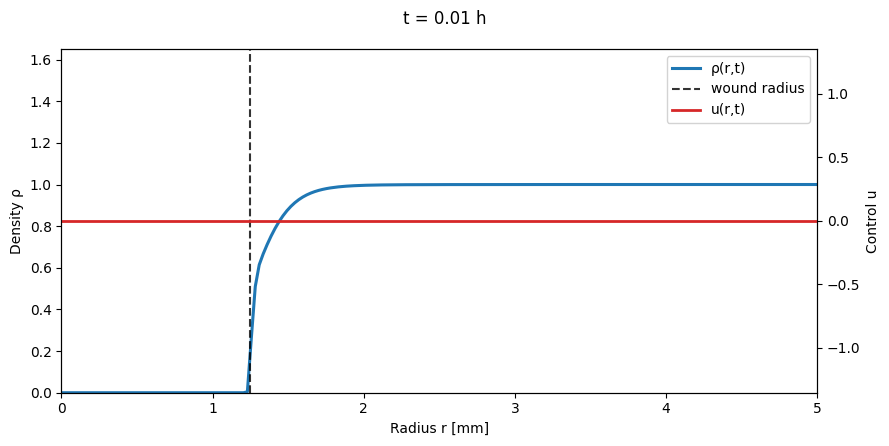

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# ------------ downsample frames (to keep HTML light) ------------
MAX_FRAMES = 240
stride = max(1, len(TT_np) // MAX_FRAMES)
inds   = np.arange(0, len(TT_np), stride, dtype=int)

RHO_s = RHO_np[inds]
UTR_s = UTR_np[inds]
RW_s  = RW_np[inds]
TT_s  = TT_np[inds].astype(float)

# ------------ axis ranges ------------
rho_min, rho_max = 0.0, float(max(1e-9, np.nanmax(RHO_np))*1.05)
u_abs = float(np.nanmax(np.abs(UTR_np))) if np.isfinite(UTR_np).any() else 1.0
u_lim = 1.05*u_abs if u_abs > 0 else 1.0

# ------------ figure with twin y-axes ------------
fig, ax_rho = plt.subplots(figsize=(9,4.5))
ax_u = ax_rho.twinx()

# primary (rho)
ax_rho.set_xlim(r_np[0], r_np[-1])
ax_rho.set_ylim(rho_min, rho_max)
(line_rho,) = ax_rho.plot(r_np, np.clip(RHO_s[0], rho_min, rho_max),
                          lw=2.2, color='tab:blue', label='ρ(r,t)')

# secondary (u)
ax_u.set_ylim(-u_lim, u_lim)
(line_u,) = ax_u.plot(r_np, UTR_s[0], lw=2.0, color='tab:red', label='u(r,t)')

# vertical rim line (draw on primary axis)
(edge_line,) = ax_rho.plot([RW_s[0], RW_s[0]], [rho_min, rho_max],
                           'k--', alpha=0.8, lw=1.5, label='wound radius')

# labels, legend, title
ax_rho.set_xlabel('Radius r [mm]')
ax_rho.set_ylabel('Density ρ')
ax_u.set_ylabel('Control u')
ttl = fig.suptitle(f"t = {float(TT_s[0]):.2f} h", y=0.98, fontsize=12)

# combine legends from both axes (de-dup)
h1, l1 = ax_rho.get_legend_handles_labels()
h2, l2 = ax_u.get_legend_handles_labels()
seen = set(); h_all=[]; l_all=[]
for h,l in list(zip(h1,l1))+list(zip(h2,l2)):
    if l not in seen:
        seen.add(l); h_all.append(h); l_all.append(l)
ax_rho.legend(h_all, l_all, loc='upper right', frameon=True, framealpha=0.85)

fig.tight_layout()

def init():
    line_rho.set_data(r_np, np.clip(RHO_s[0], rho_min, rho_max))
    line_u.set_data(r_np, UTR_s[0])
    edge_line.set_data([RW_s[0], RW_s[0]], [rho_min, rho_max])
    ttl.set_text(f"t = {float(TT_s[0]):.2f} h")
    return (line_rho, line_u, edge_line, ttl)

def update(i):
    line_rho.set_data(r_np, np.clip(RHO_s[i], rho_min, rho_max))
    line_u.set_data(r_np, UTR_s[i])
    edge_line.set_data([RW_s[i], RW_s[i]], [rho_min, rho_max])
    ttl.set_text(f"t = {float(TT_s[i]):.2f} h")
    return (line_rho, line_u, edge_line, ttl)

ani = animation.FuncAnimation(fig, update, frames=len(TT_s),
                              init_func=init, blit=False, interval=50)

HTML(ani.to_jshtml())


In [ ]:
# ======================================================================
# --- Save animation as MP4 (Option A) ---
from matplotlib import animation

# If ffmpeg isn't on PATH, set it explicitly:
# import matplotlib as mpl
# mpl.rcParams['animation.ffmpeg_path'] = "/usr/bin/ffmpeg"

fps = max(1, int(1000 / 50))  # interval=50 ms → ~20 fps
writer = animation.FFMpegWriter(fps=fps, bitrate=1800, metadata={'artist':'wound-oc'})

ani.save("density_control_combined.mp4", writer=writer, dpi=160)
#print("Saved MP4 -> wound_profiles.mp4")

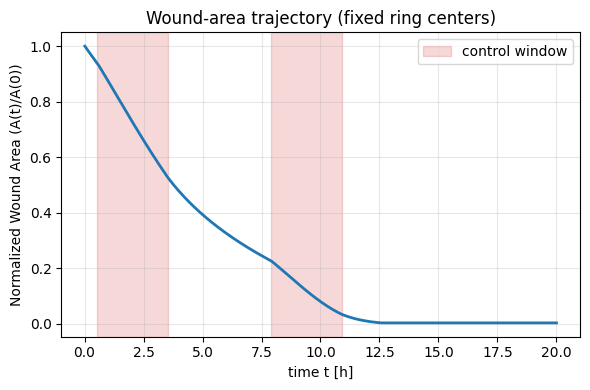

In [ ]:
# --- A(t) with pulse shading and center annotations (fixed centers) ---

# Make sure RW (wound radius over time) and TT (time grid) exist, e.g.
# RW, Utraj = full_rollout(phi_star, r_w0=2.5, rho_max=1.0, width=0.25)
# TT = np.linspace(0.0, T, Nt)   # or use the TT returned by your rollout

RW_np = np.asarray(RW, dtype=float)
TT_np = np.asarray(TT, dtype=float)

# Convert radius -> area
A_np  = np.pi * RW_np**2                  # absolute area [mm^2]
A0    = float(A_np[0])                    # initial area
A_norm = A_np / A0                        # normalized area (optional)
pct_closed = 100.0 * (1.0 - A_norm)       # % area closed (optional)

# Get pulse starts and standoffs from the optimized params
t_on_star, d_off_star = map_params(phi_star)
t_on_star  = np.atleast_1d(np.asarray(t_on_star,  dtype=float))
d_off_star = np.atleast_1d(np.asarray(d_off_star, dtype=float))

# Compute frozen ring centers r_c = r_w(t_on) + d_off  (interp r_w at pulse start)
rw_at_on = np.interp(t_on_star, TT_np, RW_np)
r_c_star = rw_at_on + d_off_star

# Plot A(t)
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(TT_np, A_norm, lw=2)
ax.set_xlabel('time t [h]')
ax.set_ylabel('Normalized Wound Area (A(t)/A(0))')
ax.set_title('Wound-area trajectory (fixed ring centers)')

# Shade each control window and annotate with r_c
ymin, ymax = ax.get_ylim()
for k, (t0, rc) in enumerate(zip(t_on_star, r_c_star)):
    t1 = min(t0 + TAU, T)
    ax.axvspan(t0, t1, color='C3', alpha=0.18,
               label='control window' if k == 0 else None)
    # place label a bit to the right of the start time
    x_text = min(t0 + 0.02*T, T*0.98)
    y_text = ymin + 0.92*(ymax - ymin)
    #ax.text(x_text, y_text, f"r_c[{k+1}] ≈ {rc:.2f} mm", fontsize=9, color='C3')

ax.grid(alpha=0.3)
if t_on_star.size > 0:
    ax.legend(loc='best', frameon=True)
plt.tight_layout()
plt.show()

# (Optional) Also show normalized area and % closed:
# fig, ax = plt.subplots(figsize=(6,4))
# ax.plot(TT_np, A_norm, lw=2, label='A(t)/A(0)')
# ax.set_xlabel('time t [h]')
# ax.set_ylabel('normalized area A/A0')
# ax.set_title('Normalized wound area and % closed')
# ax2 = ax.twinx()
# ax2.plot(TT_np, pct_closed, lw=1.5, ls='--', label='% closed', alpha=0.8)
# ax2.set_ylabel('% area closed')

# # Shade control windows
# for k, t0 in enumerate(t_on_star):
#     t1 = min(t0 + TAU, T)
#     ax.axvspan(t0, t1, color='C3', alpha=0.12)

# # Build a combined legend
# lines1, labels1 = ax.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# ax.legend(lines1 + lines2, labels1 + labels2, loc='best', frameon=True)

# ax.grid(alpha=0.3)
# plt.tight_layout()
# plt.show()



In [ ]:
@jax.jit
def full_rollout_uncontrolled(r_w0=1.25, rho_max=1.0, width=0.25):
    """
    Forward dynamics WITHOUT control: u(r,t) = 0 for all t.
    Physics, guarding, mass correction, and edge kinematics match the controlled case.
    Returns the wound radius trajectory (RW0) and a dummy u-trajectory of zeros (for symmetry).
    """
    rho, M_target = rho_init_tanh(r_w0, rho_max=rho_max, width=width)
    r_w = r_w0

    def body(carry, n):
        rho, r_w = carry

        # tissue/guard masks at current edge
        m          = jax.nn.sigmoid(KMASK * (r - r_w))
        gmask_now  = guard_mask(r, r_w)
        m_eff      = m * gmask_now

        # u = 0
        u = jnp.zeros_like(r)

        # velocity via Helmholtz closure, then guard (same as controlled case)
        rhs_v = -CHI * grad_r(rho) + u
        rhs_v = jnp.nan_to_num(rhs_v, 0.0, 0.0, 0.0)
        v = jnp.linalg.solve(A_HELM, rhs_v)
        v = m_eff * v

        # PDE step on guarded density
        rho_tissue = rho * gmask_now
        diff = D * lap_r(rho_tissue)
        adv  = -div_r_flux(rho_tissue * v)
        rhs  = (diff + adv) * m_eff
        rho_new = rho + dt * jnp.nan_to_num(rhs, 0.0, 0.0, 0.0)
        rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

        # Mass correction (tissue only)
        M_new = jnp.sum(rho_new * m_eff * r) * dr
        s = (M_target) / (M_new + EPS_DEN)
        rho_new = rho_new * (1.0 + LAMBDA_MC * (s - 1.0) * m_eff)
        rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

        # Edge kinematics (smooth sample)
        w_edge  = smooth_edge_weight(r, r_w)
        v_edge  = jnp.sum(w_edge * v)
        r_w_new = jnp.clip(r_w + dt * v_edge, 3.0*dr, R - 3.0*dr)

        return (rho_new, r_w_new), (r_w_new, u)

    (_, _), (rws0, U0) = jax.lax.scan(body, (rho, r_w), jnp.arange(Nt))
    return jnp.array(rws0), jnp.array(U0)


[it 0000] J=334.302831  r_w(T)=0.0785  t_on=[1.08492298 8.57242558]  r_c=[1.83070367 1.16976518]  edge=2.852e-02  mass=4.835e-05  safe=4.006e-05  jam=1.434e+00  offV=1.600e-01  t1pen=3.444e-02
[it 0050] J=260.249372  r_w(T)=0.0785  t_on=[0.54175657 7.89012832]  r_c=[2.13650859 1.50817429]  edge=2.842e-02  mass=3.438e-05  safe=2.652e-07  jam=1.064e+00  offV=1.421e-01  t1pen=5.377e-04
[it 0100] J=255.320611  r_w(T)=0.0785  t_on=[0.54373521 7.89407324]  r_c=[2.18074595 1.55955701]  edge=2.847e-02  mass=3.179e-05  safe=1.120e-07  jam=1.102e+00  offV=1.419e-01  t1pen=5.416e-04
[it 0150] J=253.982891  r_w(T)=0.0785  t_on=[0.54357958 7.89367737]  r_c=[2.19293501 1.57477242]  edge=2.849e-02  mass=3.110e-05  safe=8.732e-08  jam=1.119e+00  offV=1.419e-01  t1pen=5.413e-04
[it 0200] J=253.382926  r_w(T)=0.0785  t_on=[0.54360246 7.89370624]  r_c=[2.19836665 1.58174085]  edge=2.849e-02  mass=3.079e-05  safe=7.803e-08  jam=1.128e+00  offV=1.419e-01  t1pen=5.413e-04
[it 0250] J=253.052308  r_w(T)=0.07

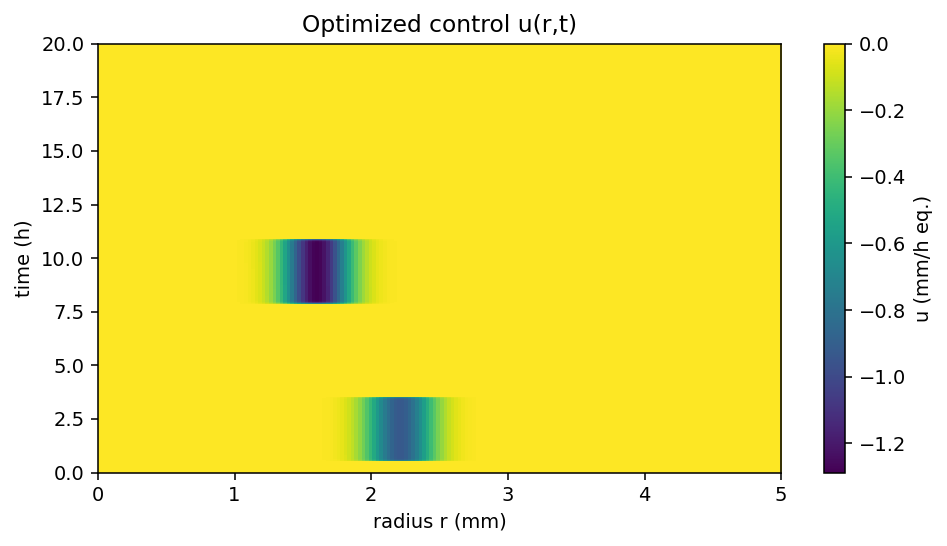

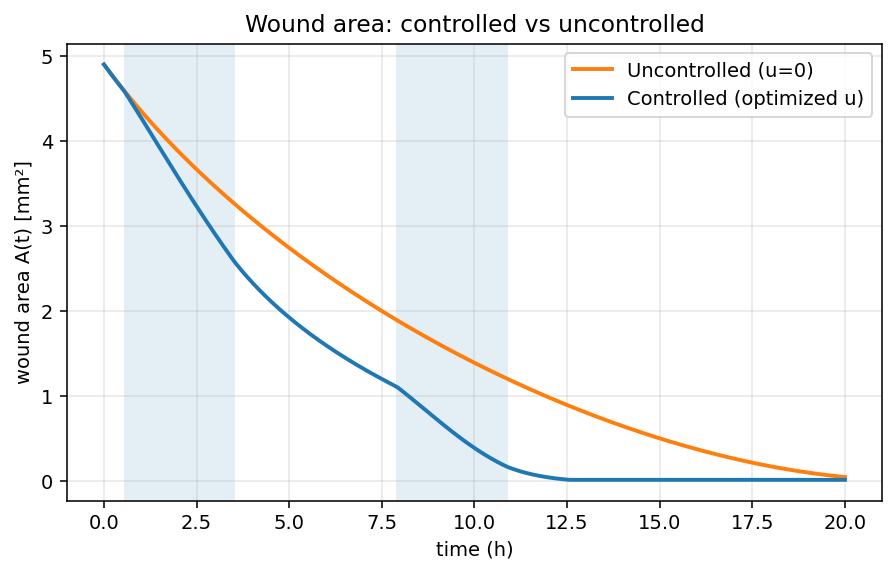

In [ ]:

import numpy as np
from pathlib import Path
# ----------------------------- Run -----------------------------

if __name__ == "__main__":
    # Optimize (controlled)
    phi_star, hist, ic = solve_with_grad(
        r_w0=1.25, rho_max=1.0, width=0.25,
        steps=800, lr=0.05, seed=0
    )

    # Controlled params & rollout
    t_on_star, d_off_star = map_params(phi_star)
    print("\nBest (feasible) parameters:")
    print("  t_on  =", np.array(t_on_star))
    print("  d_off =", np.array(d_off_star), "(standoff from r_w at turn-on)")

    RW_ctrl, Utraj = full_rollout(phi_star, r_w0=1.25, rho_max=1.0, width=0.25)
    TT = np.linspace(0.0, T, Nt)

    # Uncontrolled rollout (u=0)
    RW_unc, U0 = full_rollout_uncontrolled(r_w0=1.25, rho_max=1.0, width=0.25)

    # ---- kymograph of controlled u (unchanged) ----
    plt.figure(figsize=(7,4), dpi=140)
    extent = [0, R, TT[0], TT[-1]]
    plt.imshow(np.array(Utraj), aspect='auto', origin='lower',
               extent=extent, interpolation='nearest')
    plt.colorbar(label='u (mm/h eq.)')
    plt.xlabel("radius r (mm)"); plt.ylabel("time (h)")
    plt.title("Optimized control u(r,t)")
    plt.tight_layout(); plt.show()

    # ---- r_w(t): controlled vs uncontrolled ----
        # ---- A(t) = π * r_w(t)^2: controlled vs uncontrolled ----
    RWc = np.asarray(RW_ctrl, dtype=float)
    RWu = np.asarray(RW_unc,  dtype=float)
    Ac  = np.pi * RWc**2
    Au  = np.pi * RWu**2

    outdir = Path("results")
    outdir.mkdir(parents=True, exist_ok=True)

# Save constrained (controlled): (TT, RW, Area)
    np.savez_compressed(
    outdir / "constrained_wound_boundary_area_with_control.npz",
    TT_control=TT,
    RW_control=RWc,
    Area_control=Ac)

# Save unconstrained (u=0): (TT, RW, Area)
    np.savez_compressed(
    outdir / "constrained_wound_boundary_area_no_control.npz",
    TT_no_control=TT,
    RW_no_control=RWu,
    Area_no_control=Au)

    plt.figure(figsize=(6.5,4.2), dpi=140)
    plt.plot(TT, Au, 'C1', lw=2, label='Uncontrolled (u=0)')
    plt.plot(TT, Ac, 'C0', lw=2, label='Controlled (optimized u)')
    # shade pulse windows for readability (controlled case)
    for t0 in np.array(t_on_star, dtype=float):
        t1 = float(min(t0 + TAU, T))
        plt.axvspan(float(t0), t1, color='C0', alpha=0.12, lw=0)
    plt.xlabel("time (h)")
    plt.ylabel("wound area A(t) [mm²]")
    plt.title("Wound area: controlled vs uncontrolled")
    plt.grid(alpha=0.3)
    plt.legend()
    plt.tight_layout()
    fig.savefig("controlled_vs_uncontrolled.png", dpi=200, bbox_inches="tight")  # or plt.savefig(...)

    plt.show()

    # ---- area metrics at final time ----
    aT_ctrl = float(Ac[-1])
    aT_unc  = float(Au[-1])
    area_impr_abs = aT_unc - aT_ctrl
    area_impr_pct = 100.0 * (area_impr_abs / aT_unc) if aT_unc > 0 else np.nan

    #print(f"\nFinal wound area A(T):")
    #print(f"  Uncontrolled: {aT_unc:.4f} mm^2")
    #print(f"  Controlled:   {aT_ctrl:.4f} mm^2")
    #print(f"Improvement (absolute): {area_impr_abs:.4f} mm^2 smaller at T")
    #print(f"Improvement (relative): {area_impr_pct:.2f}% smaller at T")


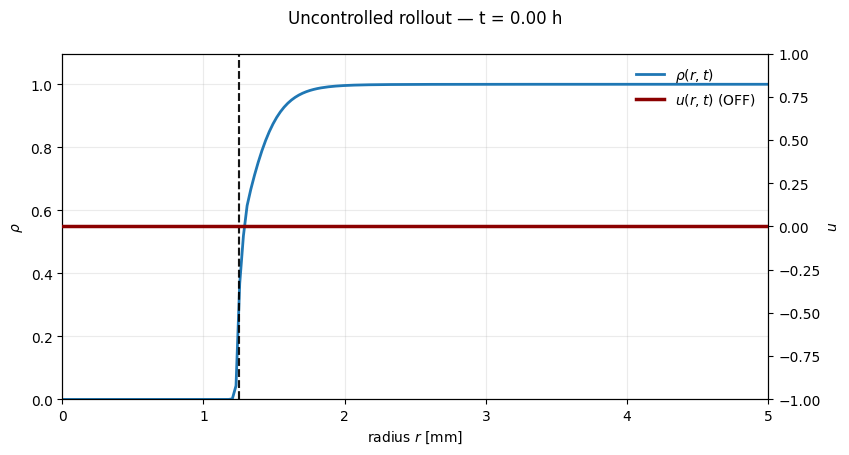

In [ ]:
# ========= Uncontrolled rollout that RECORDS full rho(t, r) and u(t, r)=0 =========
@jax.jit
def full_rollout_uncontrolled_record(r_w0=1.25, rho_max=1.0, width=0.25):
    """
    Forward dynamics WITHOUT control: u(r,t) = 0 for all t.
    Records rho(t,r), u(t,r)=0, and r_w(t). Numerics match the controlled case.
    """
    rho, M_target = rho_init_tanh(r_w0, rho_max=rho_max, width=width)
    r_w = r_w0

    def body(carry, n):
        rho, r_w = carry

        # tissue/guard masks at current edge
        m          = jax.nn.sigmoid(KMASK * (r - r_w))
        gmask_now  = guard_mask(r, r_w)
        m_eff      = m * gmask_now

        # u = 0 (everywhere)
        u = jnp.zeros_like(r)

        # velocity via Helmholtz closure, then guard (same as controlled case)
        rhs_v = -CHI * grad_r(rho) + u
        rhs_v = jnp.nan_to_num(rhs_v, 0.0, 0.0, 0.0)
        v = jnp.linalg.solve(A_HELM, rhs_v)
        v = m_eff * v

        # PDE step on guarded density
        rho_tissue = rho * gmask_now
        diff = D * lap_r(rho_tissue)
        adv  = -div_r_flux(rho_tissue * v)
        rhs  = (diff + adv) * m_eff
        rho_new = rho + dt * jnp.nan_to_num(rhs, 0.0, 0.0, 0.0)
        rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

        # Mass correction (tissue only)
        M_new = jnp.sum(rho_new * m_eff * r) * dr
        s = (M_target) / (M_new + EPS_DEN)
        rho_new = rho_new * (1.0 + LAMBDA_MC * (s - 1.0) * m_eff)
        rho_new = jnp.clip(rho_new, RHO_FLOOR, RHO_MAX)

        # Edge kinematics (smooth sample)
        w_edge  = smooth_edge_weight(r, r_w)
        v_edge  = jnp.sum(w_edge * v)
        r_w_new = jnp.clip(r_w + dt * v_edge, 3.0*dr, R - 3.0*dr)

        # Record AFTER the step: (rho_new, u (zeros), r_w_new)
        return (rho_new, r_w_new), (rho_new, u, r_w_new)

    (_, _), (RHO0, U0, RW0) = jax.lax.scan(body, (rho, r_w), jnp.arange(Nt))
    return jnp.array(RHO0), jnp.array(U0), jnp.array(RW0)


# ========= Animate BOTH rho(r,t) and u(r,t) on ONE plot (twin y-axes) =========
from matplotlib import animation
from IPython.display import HTML

# Compute uncontrolled fields
RHO0, U0, RW_unc = full_rollout_uncontrolled_record(r_w0=1.25, rho_max=1.0, width=0.25)

# To NumPy for plotting
RHO0_np = np.asarray(RHO0)          # (Nt, Nr)
U0_np   = np.asarray(U0)            # (Nt, Nr) zeros
RWu_np  = np.asarray(RW_unc)        # (Nt,)
TT_np   = np.linspace(0.0, T, Nt)   # match your global T, Nt
r_np    = np.asarray(r)             # (Nr,)

# Downsample frames for lighter HTML (optional)
MAX_FRAMES = 240
stride = max(1, len(TT_np) // MAX_FRAMES)
inds   = np.arange(0, len(TT_np), stride, dtype=int)

RHO_s = RHO0_np[inds]
U_s   = U0_np[inds]
RW_s  = RWu_np[inds]
TT_s  = TT_np[inds].astype(float)

# Axis setup
fig, ax = plt.subplots(1, 1, figsize=(8.6, 4.6))
ax2 = ax.twinx()  # secondary y-axis for u

# X and Y ranges
ax.set_xlim(0, R)
rho_ymin, rho_ymax = 0.0, float(np.nanmax(RHO0_np) * 1.05 if np.nanmax(RHO0_np) > 0 else 1.0)
ax.set_ylim(rho_ymin, rho_ymax)

u_abs = float(np.nanmax(np.abs(U0_np)))
u_ylim = (-1.0, 1.0) if not np.isfinite(u_abs) or u_abs == 0.0 else (-1.05*u_abs, 1.05*u_abs)
ax2.set_ylim(*u_ylim)

# Plot objects
(line_rho,) = ax.plot(r_np, np.clip(RHO_s[0], rho_ymin, rho_ymax), lw=2, label=r'$\rho(r,t)$')
(line_u,) = ax2.plot(
    r_np, U_s[0],
    lw=2.5,
    color='#8B0000',   # dark red
    alpha=1.0,
    zorder=5,
    label=r'$u(r,t)$ (OFF)'
)

# Vertical wound rim on both axes (so it spans both y-ranges)
(edge_rho,) = ax.plot([RW_s[0], RW_s[0]], [rho_ymin, rho_ymax], 'k--', alpha=0.7)
(edge_u,)   = ax2.plot([RW_s[0], RW_s[0]], [u_ylim[0], u_ylim[1]], 'k--', alpha=0.7)

# Labels, titles, legends
ax.set_xlabel('radius $r$ [mm]')
ax.set_ylabel(r'$\rho$')
ax2.set_ylabel(r'$u$')

ttl = fig.suptitle(f"Uncontrolled rollout — t = {TT_s[0]:.2f} h", y=0.98, fontsize=12)
#ax.set_title(r'$\rho(r,t)$ and $u(r,t)$ (single panel, twin $y$-axes)')
ax.grid(alpha=0.25)

# Combined legend (gather handles from both axes)
h1, l1 = ax.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()
ax.legend(h1 + h2, l1 + l2, loc='upper right', frameon=False)

plt.tight_layout()

def init():
    line_rho.set_data(r_np, np.clip(RHO_s[0], rho_ymin, rho_ymax))
    line_u.set_data(r_np, U_s[0])

    edge_rho.set_data([RW_s[0], RW_s[0]], [rho_ymin, rho_ymax])
    edge_u.set_data([RW_s[0], RW_s[0]], [u_ylim[0], u_ylim[1]])

    ttl.set_text(f"Uncontrolled rollout — t = {TT_s[0]:.2f} h")
    return line_rho, line_u, edge_rho, edge_u, ttl

def update(i):
    line_rho.set_data(r_np, np.clip(RHO_s[i], rho_ymin, rho_ymax))
    line_u.set_data(r_np, U_s[i])  # stays zero for all t (OFF)

    edge_rho.set_data([RW_s[i], RW_s[i]], [rho_ymin, rho_ymax])
    edge_u.set_data([RW_s[i], RW_s[i]], [u_ylim[0], u_ylim[1]])

    ttl.set_text(f"Uncontrolled rollout — t = {TT_s[i]:.2f} h")
    return line_rho, line_u, edge_rho, edge_u, ttl

ani = animation.FuncAnimation(
    fig, update, frames=len(TT_s),
    init_func=init, blit=False, interval=50
)

# In notebooks:
#HTML(ani.to_jshtml())
# Or save:
ani.save("uncontrolled_rho_and_u_single_panel.mp4", dpi=140, fps=20)
# ani.save("uncontrolled_rho_and_u_single_panel.gif", dpi=100, fps=15)


#Loading and Plotting data

In [ ]:
cd domain_r_5/

/content/gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained/domain_r_5


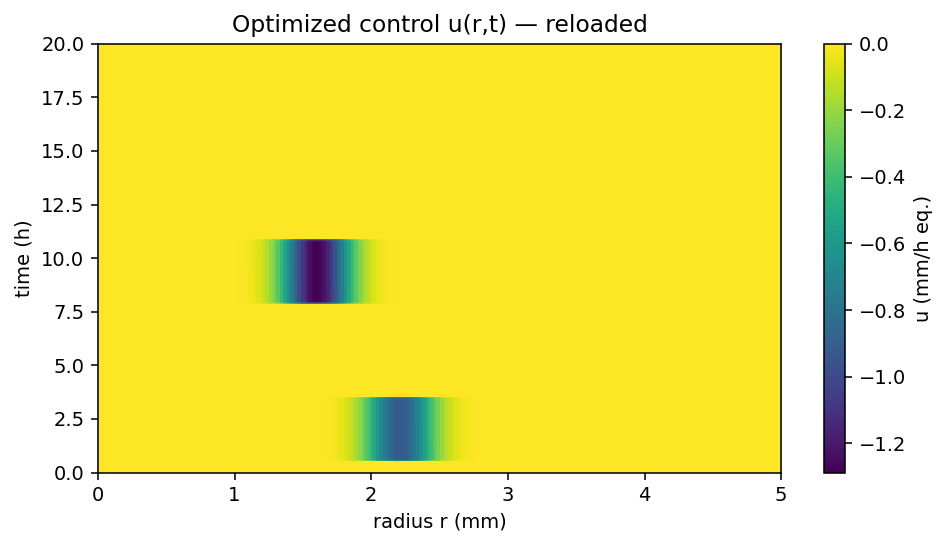

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

data = np.load("u_traj_run1_R_5.npz")
U = data["U"]          # (Nt, Nr)
r = data["r"]          # (Nr,)
t = data["t"]          # (Nt,)
extent = data["extent"]# [r_min, r_max, t_min, t_max]

plt.figure(figsize=(7,4), dpi=140)
plt.imshow(U, aspect='auto', origin='lower', extent=extent, interpolation='nearest')
plt.colorbar(label='u (mm/h eq.)')
plt.xlabel("radius r (mm)"); plt.ylabel("time (h)")
plt.title("Optimized control u(r,t) — reloaded")
plt.tight_layout(); plt.show()

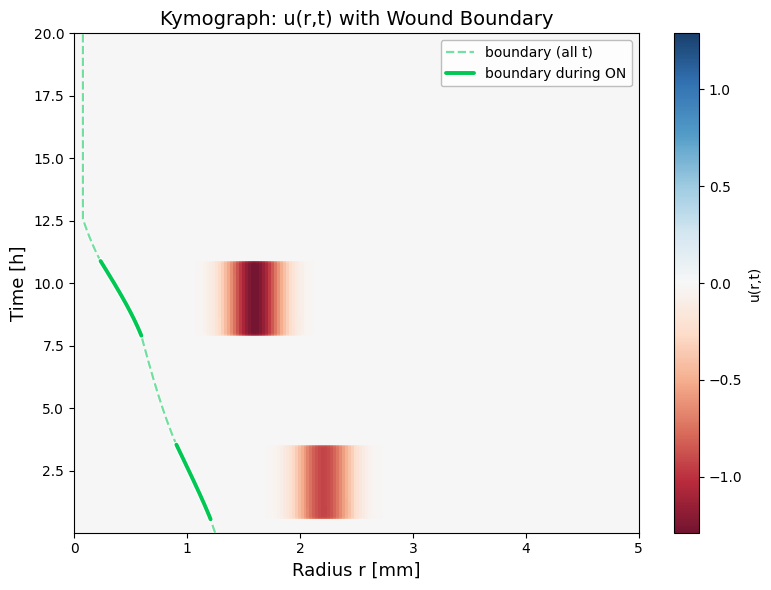

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
from pathlib import Path

# Inputs expected:
# UTR_np: (Nt, Nr) control field u(t, r)
# TT_np : (Nt,)    time grid
# r_np  : (Nr,)    radius grid
# RW_np : (Nt,)    wound boundary radius r_w(t)

# (Optional) derive ON intervals from UTR_np to emphasize boundary during ON
on_frac = np.mean(np.abs(UTR_np) > 1e-10, axis=1)
on_mask = (on_frac > 0.0).astype(int)
starts = np.where((on_mask[1:] == 1) & (on_mask[:-1] == 0))[0] + 1
ends   = np.where((on_mask[1:] == 0) & (on_mask[:-1] == 1))[0] + 1
if on_mask[0] == 1: starts = np.r_[0, starts]
if on_mask[-1] == 1: ends = np.r_[ends, len(on_mask)]

# --- Plot ---
fig, ax = plt.subplots(figsize=(8,6))

vabs = float(np.nanmax(np.abs(UTR_np))) if np.isfinite(UTR_np).any() else 1.0
im = ax.imshow(
    UTR_np, aspect='auto', origin='lower',
    extent=[r_np[0], r_np[-1], TT_np[0], TT_np[-1]],
    cmap='RdBu', vmin=-vabs, vmax=vabs, interpolation='nearest'
)
im.set_alpha(0.92)  # helps overlays stand out
fig.colorbar(im, ax=ax, label="u(r,t)")

# Full boundary as context (dashed)
green = "#00c853"
ax.plot(
    RW_np, TT_np, linestyle='--', color=green, lw=1.6, alpha=0.55, zorder=3,
    path_effects=[pe.Stroke(linewidth=3.0, foreground='white', alpha=0.75), pe.Normal()],
    label="boundary (all t)"
)

# Boundary during ON segments (thicker solid)
first = True
for s, e in zip(starts, ends):
    if e > s:
        ax.plot(
            RW_np[s:e], TT_np[s:e],
            color=green, lw=2.8, solid_capstyle='round', zorder=4,
            path_effects=[pe.Stroke(linewidth=4.4, foreground='white'), pe.Normal()],
            label="boundary during ON" if first else None
        )
        first = False

# Labels, legend, finish
ax.set_xlabel("Radius r [mm]", fontsize=13)
ax.set_ylabel("Time [h]", fontsize=13)
ax.set_title("Kymograph: u(r,t) with Wound Boundary", fontsize=14)
ax.grid(False)

# De-duplicate legend entries
handles, labels = ax.get_legend_handles_labels()
uniq = dict(zip(labels, handles))
ax.legend(uniq.values(), uniq.keys(), loc='upper right',
          frameon=True, framealpha=0.85, facecolor='white', edgecolor='0.7', fontsize=10)

fig.tight_layout()
#Path("results").mkdir(parents=True, exist_ok=True)
#fig.savefig("results/kymo_u_with_boundary.pdf", bbox_inches="tight")
plt.show()


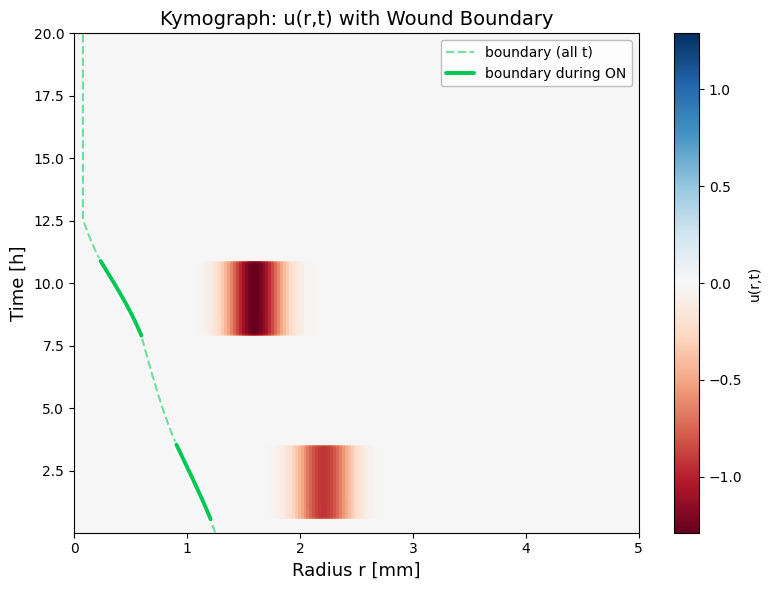

In [ ]:
# ==== Kymograph: u(r,t) with wound boundary RW(t) + yellow plot background ====
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
from pathlib import Path

# # --- Try to load from NPZ; else expect in-memory arrays with same names ---
# maybe = Path("results/wound_kymo_with_boundary_data.npz")
# if maybe.exists():
#     data = np.load(maybe, allow_pickle=True)
#     UTR_np = data["UTR"]          # (Nt, Nr)
#     TT_np  = data["TT"].astype(float)   # (Nt,)
#     r_np   = data["r"].astype(float)    # (Nr,)
#     RW_np  = data["RW"].astype(float)   # (Nt,)
# else:
#     # Expect these to already be defined in your session:
#     # UTR_np: (Nt, Nr), TT_np: (Nt,), r_np: (Nr,), RW_np: (Nt,)
#     for name in ("UTR_np","TT_np","r_np","RW_np"):
#         if name not in globals():
#             raise RuntimeError(f"'{name}' is missing. Either define it, or save/load the NPZ at {maybe!s}.")

# --- Derive ON intervals from UTR_np (any |u|>1e-10 across r means ON) ---
on_frac = np.mean(np.abs(UTR_np) > 1e-10, axis=1)
on_mask = (on_frac > 0.0).astype(int)
starts = np.where((on_mask[1:] == 1) & (on_mask[:-1] == 0))[0] + 1
ends   = np.where((on_mask[1:] == 0) & (on_mask[:-1] == 1))[0] + 1
if on_mask[0] == 1: starts = np.r_[0, starts]
if on_mask[-1] == 1: ends = np.r_[ends, len(on_mask)]

# --- Figure & Axes (yellow plot background only) ---
fig, ax = plt.subplots(figsize=(8,6))
ax.set_facecolor("#fff9c4")  # soft yellow axes background; figure bg unchanged

# --- Heatmap ---
vabs = float(np.nanmax(np.abs(UTR_np))) if np.isfinite(UTR_np).any() else 1.0
im = ax.imshow(
    UTR_np, aspect='auto', origin='lower',
    extent=[r_np[0], r_np[-1], TT_np[0], TT_np[-1]],
    cmap='RdBu', vmin=-vabs, vmax=vabs, interpolation='nearest'
)
fig.colorbar(im, ax=ax, label="u(r,t)")

# --- Boundary overlays (green with white halo) ---
green = "#00c853"; lw_all = 1.6; lw_on = 2.8

# full boundary (context)
ax.plot(
    RW_np, TT_np, linestyle='--', color=green, lw=lw_all, alpha=0.55, zorder=3,
    path_effects=[pe.Stroke(linewidth=lw_all+1.6, foreground='white', alpha=0.75), pe.Normal()],
    label="boundary (all t)"
)

# ON segments (thicker, solid)
first = True
for s, e in zip(starts, ends):
    if e > s:
        ax.plot(
            RW_np[s:e], TT_np[s:e],
            color=green, lw=lw_on, solid_capstyle='round', zorder=4,
            path_effects=[pe.Stroke(linewidth=lw_on+2.0, foreground='white'), pe.Normal()],
            label="boundary during ON" if first else None
        )
        first = False

# --- Labels, legend, tidy ---
ax.set_xlabel("Radius r [mm]", fontsize=13)
ax.set_ylabel("Time [h]", fontsize=13)
ax.set_title("Kymograph: u(r,t) with Wound Boundary", fontsize=14)
ax.grid(False)

# De-duplicate legend entries
handles, labels = ax.get_legend_handles_labels()
uniq = dict(zip(labels, handles))
ax.legend(uniq.values(), uniq.keys(), loc='upper right',
          frameon=True, framealpha=0.85, facecolor='white', edgecolor='0.7', fontsize=10)

fig.tight_layout()
#Path("results").mkdir(parents=True, exist_ok=True)
fig.savefig("kymo_u_with_wound_boundary.pdf",
            bbox_inches="tight", facecolor=fig.get_facecolor())  # preserve bg in save
plt.show()
# ==== end ====


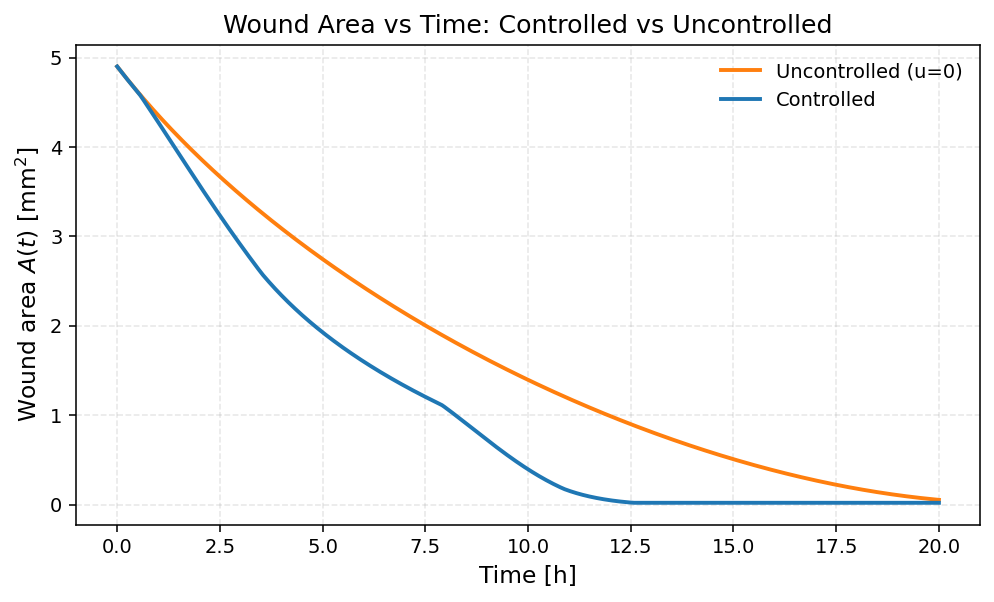

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# --- Paths ---
outdir = Path("results")
f_ctrl = outdir / "constrained_wound_boundary_area_with_control.npz"
f_unc  = outdir / "constrained_wound_boundary_area_no_control.npz"

# --- Load ---
D_ctrl = np.load(f_ctrl)
D_unc  = np.load(f_unc)

TTc = np.asarray(D_ctrl["TT_control"], dtype=float).ravel()
Ac  = np.asarray(D_ctrl["Area_control"], dtype=float).ravel()

TTu = np.asarray(D_unc["TT_no_control"], dtype=float).ravel()
Au  = np.asarray(D_unc["Area_no_control"], dtype=float).ravel()

# --- (Optional) safety: sort by time in case arrays aren’t sorted ---
sort_c = np.argsort(TTc)
sort_u = np.argsort(TTu)
TTc, Ac = TTc[sort_c], Ac[sort_c]
TTu, Au = TTu[sort_u], Au[sort_u]

# --- Plot ---
plt.figure(figsize=(7.2, 4.4), dpi=140)
plt.plot(TTu, Au,  lw=2, color="C1", label="Uncontrolled (u=0)")
plt.plot(TTc, Ac,  lw=2, color="C0", label="Controlled")

plt.xlabel("Time [h]", fontsize=12)
plt.ylabel(r"Wound area $A(t)$ [mm$^2$]", fontsize=12)
plt.title("Wound Area vs Time: Controlled vs Uncontrolled", fontsize=13)
plt.grid(alpha=0.3, linestyle="--")
plt.legend(frameon=False)
plt.tight_layout()

# --- Save & show ---
out_path = outdir / "wound_area_control_vs_uncontrolled.png"
plt.savefig(out_path, dpi=200, bbox_inches="tight")
plt.show()

#print(f"Saved figure to: {out_path}")


In [ ]:
pwd

'/content/gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained/domain_r_5'

In [ ]:
cd results/

/content/gdrive/MyDrive/jeremy_wound_healing/raw_data/experimentally_constrained/domain_r_5/results


In [ ]:
ls

constrained_wound_boundary_area_no_control.npz
constrained_wound_boundary_area_with_control.npz
wound_area_control_vs_uncontrolled.png
